<a href="https://colab.research.google.com/github/NicoWeiner/MasterProject/blob/master/Immobilienscout24%20Analysis%20Notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Immobilienscout24 Analysis Notebook

## 1.  Importing packages & the Immobilienscout24 scraped data 

In [1]:
!pip install pandas 
!pip install gensim
!pip install spacy
!pip install gensim
!pip install matplotlib
!pip install sklearn
!pip install keras
!pip install tensorflow
!pip install scikit-learn
!pip install scipy
!pip install nltk
!pip install random2
!pip install warnings-plugin
!pip install statsmodels
!pip install seaborn
!pip install DateTime
!pip install datetime3

import gensim
import numpy as np
import spacy
from spacy import displacy
from gensim.corpora import Dictionary
from gensim.models import LdaModel
import matplotlib.pyplot as plt
import keras
import tensorflow
import statsmodels.api as sm
import sklearn
import sklearn.preprocessing
from sklearn.linear_model import LinearRegression
from scipy import stats
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import NMF
import random
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
import warnings
warnings.filterwarnings('ignore')
warnings.filterwarnings('ignore', category=DeprecationWarning)
from pandas import DataFrame, read_csv
import pandas as pd
pd.options.mode.chained_assignment = None  # default='warn'
import warnings
import os
warnings.filterwarnings('ignore')  # Let's not pay heed to them right now
%matplotlib inline

#For Scikit Regression: 

from datetime import datetime
from sklearn import preprocessing
from sklearn.model_selection import KFold
from sklearn.metrics import mean_squared_error, r2_score
from keras.callbacks import ModelCheckpoint
from keras.models import Sequential
from keras.layers import Dense, Activation, Flatten
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error 
from matplotlib import pyplot as plt
import seaborn as sb
import matplotlib.pyplot as plt
import tensorflow as tf

%matplotlib notebook


Using TensorFlow backend.
/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [2]:
immodf = pd.read_csv("https://www.dropbox.com/s/04s1ptlkvy5l61s/FINAL_IMMOBILIENSCOUT24_03_05_20.csv?dl=1", sep=',', parse_dates=['Baujahr', 'Bezugsfrei_ab'], error_bad_lines=False, dtype='unicode', lineterminator='\n')
pd.options.display.max_columns = None
immodf.head(5)


,ID,ScoutID,Typ,Kaufpreis,Provision,Energieeffizienzklasse,Objektzustand,Anzahl_zimmer,Wohnflaeche (in m²),Grundstueck (in m²),Baujahr,Bezugsfrei_ab,Title,Beschreibung,Ausstattung,Lagebeschreibung,Sonstiges,PLZ,Stadt,Ortsteil,ScrapingDate1,ScrapingDate2,ScrapingDate3,ScrapingDate4,timetosell,Flaeche_km2,Einwohner,Men,Women,Population_density,Average_income
0,115756801,Objekt-Nr.: FB211 | Scout-ID: 115756801,Bungalow,518500.0,Nein,A+,Erstbezug,3.0,160.0,1200.0,2020,NaN,Zeitlose Ästhetik im Bauhaus-Stil! Jetzt Onlin...,+++Gerne bietet Kern-Haus Ihnen eine umfangrei...,"3 Zimmer, offene Küche, Diele, Bad, Dusche, Ha...","Das Baugrundstück befindet sich in Dauernheim,...",Kern-Haus baut individuelle und massive Archit...,63691,Ranstadt,Wetteraukreis,2020-04-21,NaN,NaN,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN
1,116853306,Objekt-Nr.: 562020 | Scout-ID: 116853306,Einfamilienhaus (freistehend),301667.0,Nein,NaN,Erstbezug,4.0,135.0,860.0,NaN,NaN,Bauen statt Miete zahlen! Ihr neues Zuhause in...,Das LifeStyle 13.10 S bietet Ihnen und Ihrer F...,In dem oben genannten Kaufpreis wurden die Kos...,Die Häuser werden auf realen Grundstücken ange...,Deutschland`s meistverkaufte Ausbauhäuser!\n\n...,52385,Nideggen,Düren,2020-04-21,NaN,NaN,NaN,4,65.04,9945.0,4902.0,5043.0,153.0,NaN
2,116959865,Objekt-Nr.: W16091 | Scout-ID: 116959865,Einfamilienhaus (freistehend),225900.0,Nein,A+,Erstbezug,3.0,76.0,612.0,2021,NaN,Wohnen und leben auf einer Ebene!,+++Gerne bietet Kern-Haus Ihnen eine umfangrei...,"3 Zimmer, offene Küche, Diele mit Garderobe, B...",- Grundstück befindet sich in Elstertrebnitz i...,Kern-Haus\r\n\r\nKern-Haus baut individuelle u...,04523,Pegau,Leipzig,2020-04-21,2020-04-25,2020-04-29,NaN,12,48.8,6288.0,3068.0,3220.0,129.0,NaN
3,116953174,Scout-ID: 116953174,Einfamilienhaus (freistehend),218659.0,Nein,NaN,Erstbezug,6.0,144.0,550.0,2020,NaN,Das neue LifeStyle 14.03S ! Auch als Stadtvill...,Jeder von uns hat Träume. Ein eigenes Haus zu ...,ZERTIFIZIERTE QUALITÄT IN ALLEN BEREICHEN!\n\n...,"Ich bin Ihr Ansprechpartner in Ihrer Region, w...",Profitieren Sie vom aktuell niedrigen Zinsnive...,52428,52428,Jülich,2020-04-21,2020-04-25,2020-04-29,NaN,12,NaN,NaN,NaN,NaN,NaN,NaN
4,116953218,Scout-ID: 116953218,Einfamilienhaus (freistehend),287200.0,Nein,NaN,Erstbezug,4.0,141.0,801.0,NaN,NaN,"Barriere freier Bungalow in Kehrigk , jetzt ko...",Dieses Angebot beinhaltet:\n\n- Projektiertes ...,"Ein wahrliches traumhaftes Haus, was ihrer Fam...",Das Grundstück liegt in Kehrigk\n15859 Storkow...,Auch ohne Eigenkapital bauen !! \nProfitieren ...,15859,Storkow,Storkow,2020-04-21,2020-04-25,2020-04-29,NaN,12,NaN,NaN,NaN,NaN,NaN,NaN


## 2.  Run NFM Model to extract common topics in listing descriptions



### 2.1. Removing all German stopwords in the listing descriptions as we only want to extract the relevant words

In [4]:
stopWords = set (stopwords.words('german'))

print(len(stopWords))
print(stopWords)

232
{'jedem', 'ihres', 'wieder', 'zur', 'da', 'unseres', 'einem', 'einigen', 'sein', 'keiner', 'jetzt', 'unserem', 'haben', 'jeden', 'meines', 'zwar', 'könnte', 'aller', 'bin', 'ob', 'etwas', 'sie', 'diesem', 'weil', 'bist', 'nur', 'welches', 'diesen', 'war', 'derselbe', 'muss', 'der', 'jeder', 'zum', 'jene', 'derer', 'einen', 'selbst', 'seines', 'deinem', 'einiger', 'waren', 'einmal', 'denselben', 'desselben', 'eurem', 'dieser', 'über', 'unter', 'gegen', 'solchen', 'euch', 'nichts', 'einige', 'ihren', 'jenem', 'mein', 'keinen', 'solchem', 'deine', 'als', 'anderm', 'soll', 'von', 'wirst', 'dir', 'einer', 'unsere', 'er', 'werde', 'wir', 'aber', 'deines', 'keine', 'anderer', 'zwischen', 'oder', 'durch', 'indem', 'wenn', 'jedes', 'will', 'wird', 'um', 'dieselbe', 'einigem', 'euer', 'eurer', 'habe', 'welcher', 'allen', 'wo', 'eines', 'solche', 'aus', 'werden', 'derselben', 'jener', 'dort', 'zu', 'dasselbe', 'daß', 'du', 'vor', 'viel', 'mancher', 'meinem', 'dieses', 'die', 'demselben', 'sic

In [0]:
tfidf_vect = TfidfVectorizer(max_df=0.8, min_df=2, stop_words=stopWords, token_pattern='[a-zA-Z][a-zA-Z]{2,}')
doc_term_matrix = tfidf_vect.fit_transform(immodf['Beschreibung'].values.astype('U'))


### 2.2. Creating a probability matrix for topics

In [7]:
nmf = NMF(n_components=25, random_state=42)
nmf.fit(doc_term_matrix)

NMF(alpha=0.0, beta_loss='frobenius', init=None, l1_ratio=0.0, max_iter=200,
    n_components=25, random_state=42, shuffle=False, solver='cd', tol=0.0001,
    verbose=0)

In [0]:
#retrieve the probability vector of words 

first_topic = nmf.components_[1]
top_topic_words = first_topic.argsort()[-10:]

### 2.3. Extracting top words for 25 topics

In [9]:
#the words in the data grouped by topics

for i,topic in enumerate(nmf.components_):
    print(f'Top words for topic #{i}:')
    print([tfidf_vect.get_feature_names()[i] for i in topic.argsort()[-15:]])
    print('\n')

Top words for topic #0:
['offene', 'giges', 'gig', 'dusche', 'kamin', 'wohnbereich', 'garten', 'ste', 'zugang', 'terrasse', 'wohn', 'gigen', 'essbereich', 'gige', 'gro']


Top words for topic #1:
['garageninnenhof', 'garagenraum', 'garagenkeller', 'garagenmiete', 'garagennebengeb', 'garagenneubau', 'garagennutzung', 'garagenparkplatz', 'garagenparzelle', 'garagenpl', 'garagenplatz', 'garagenplatzes', 'garagenkomplex', 'zzt', 'nan']


Top words for topic #2:
['wfl', 'wunschimmobilie', 'notarkosten', 'preisg', 'montag', 'nachlass', 'ausgabe', 'immobilienversteigerungs', 'kataloginfos', 'kataloges', 'versteigert', 'eur', 'sichern', 'verkehrswert', 'telefonnummer']


Top words for topic #3:
['mieter', 'insgesamt', 'derzeit', 'eur', 'mieteinnahmen', 'garagen', 'stellpl', 'drei', 'tze', 'jeweils', 'zwei', 'wohneinheiten', 'vermietet', 'mehrfamilienhaus', 'wohnungen']


Top words for topic #4:
['senden', 'interesse', 'eigent', 'pers', 'besichtigungstermin', 'nnen', 'vollst', 'immobilie', 'erh

In [10]:
# Append new column with topics as numerical values
test = immodf

topic_values = nmf.transform(doc_term_matrix)
test['Topic'] = topic_values.argmax(axis=1)
test.head(3)

,ID,ScoutID,Typ,Kaufpreis,Provision,Energieeffizienzklasse,Objektzustand,Anzahl_zimmer,Wohnflaeche (in m²),Grundstueck (in m²),Baujahr,Bezugsfrei_ab,Title,Beschreibung,Ausstattung,Lagebeschreibung,Sonstiges,PLZ,Stadt,Ortsteil,ScrapingDate1,ScrapingDate2,ScrapingDate3,ScrapingDate4,timetosell,Flaeche_km2,Einwohner,Men,Women,Population_density,Average_income,Topic
0,115756801,Objekt-Nr.: FB211 | Scout-ID: 115756801,Bungalow,518500.0,Nein,A+,Erstbezug,3.0,160.0,1200.0,2020,NaN,Zeitlose Ästhetik im Bauhaus-Stil! Jetzt Onlin...,+++Gerne bietet Kern-Haus Ihnen eine umfangrei...,"3 Zimmer, offene Küche, Diele, Bad, Dusche, Ha...","Das Baugrundstück befindet sich in Dauernheim,...",Kern-Haus baut individuelle und massive Archit...,63691,Ranstadt,Wetteraukreis,2020-04-21,NaN,NaN,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN,0
1,116853306,Objekt-Nr.: 562020 | Scout-ID: 116853306,Einfamilienhaus (freistehend),301667.0,Nein,NaN,Erstbezug,4.0,135.0,860.0,NaN,NaN,Bauen statt Miete zahlen! Ihr neues Zuhause in...,Das LifeStyle 13.10 S bietet Ihnen und Ihrer F...,In dem oben genannten Kaufpreis wurden die Kos...,Die Häuser werden auf realen Grundstücken ange...,Deutschland`s meistverkaufte Ausbauhäuser!\n\n...,52385,Nideggen,Düren,2020-04-21,NaN,NaN,NaN,4,65.04,9945.0,4902.0,5043.0,153.0,NaN,12
2,116959865,Objekt-Nr.: W16091 | Scout-ID: 116959865,Einfamilienhaus (freistehend),225900.0,Nein,A+,Erstbezug,3.0,76.0,612.0,2021,NaN,Wohnen und leben auf einer Ebene!,+++Gerne bietet Kern-Haus Ihnen eine umfangrei...,"3 Zimmer, offene Küche, Diele mit Garderobe, B...",- Grundstück befindet sich in Elstertrebnitz i...,Kern-Haus\r\n\r\nKern-Haus baut individuelle u...,04523,Pegau,Leipzig,2020-04-21,2020-04-25,2020-04-29,NaN,12,48.8,6288.0,3068.0,3220.0,129.0,NaN,24


### 2.4. Give suitable topics a title 

Considering the output of the 25 topics above, we now select the ones that make sense and are suitable and categorize them with a name. The category name tells what a house description is focusing on. The ones that are do not make sense are later being dropped. 


In [0]:
# Insert the output in dataset as new variables

test.Topic = test.Topic.astype('str')

test.Topic = test.Topic.replace(['1'],'garage')
test.Topic = test.Topic.replace(['2'],'house_auction')
test.Topic = test.Topic.replace(['3', '16'],'multi_dwelling')
test.Topic = test.Topic.replace(['4'],'house_viewing')
test.Topic = test.Topic.replace(['7'],'renovated')
test.Topic = test.Topic.replace(['13'],'house_layout')
test.Topic = test.Topic.replace(['5', '22'],'courtyard_estate')

In [0]:
test = test.astype('str')


## 3. Import results of LIWC analysis & merge with Immoscout data

Outside of this notebook, the program LIWC2015 has been purchased which allowed to run multi-level linguistic analysis on the listing descriptions. The analysis has been conducted within the program LIWC2015, resulting in a new dataset with new columns that indicate the level of various linguistic features and sentiment. For more details on the particular linguistic feature, see: https://liwc.wpengine.com/compare-dictionaries/

In [0]:
liwc1 = pd.read_csv("https://www.dropbox.com/s/yse4stsaf42aeo9/LIWC2015%20Results%20%28FINAL_IMMOBILIENSCOUT24_03_05_20.csv%29.csv?dl=1", sep=',', error_bad_lines=False, dtype='unicode', lineterminator='\n')
pd.options.display.max_columns = None

In [14]:
liwc2 = liwc1
liwc2 = liwc2.drop(['B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z', 'AA', 'AB', 'AC', 'AD', 'AE', 'filler\r'], axis=1) 
liwc2 = liwc2.astype('str')
liwc2


,A,WC,Analytic,Clout,Authentic,Tone,WPS,Sixltr,Dic,ppron,i,we,you,shehe,they,affect,posemo,negemo,anx,anger,sad,social,family,friend,female,male,cogproc,insight,cause,discrep,tentat,certain,differ,percept,see,hear,feel,drives,affiliation,achieve,power,reward,risk,focuspast,focuspresent,focusfuture,work,leisure,home,money,relig,death,informal,swear,netspeak,assent,nonflu
0,115756801,260,92.13,46.92,1.00,32.37,15.29,32.31,9.23,0.77,0.77,0.00,0.00,0.00,0.00,0.38,0.38,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.38,0.38,0.00,0.00,0.00,0.00,0.00,0.38,0.00,0.38,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.38,2.69,0.00,0.38,1.15,2.31,0.00,0.00,1.54,0.00,0.00,0.00,0.00,0.00
1,116853306,162,93.82,45.10,1.00,25.77,13.50,35.19,4.94,0.62,0.62,0.00,0.00,0.00,0.00,1.23,0.62,0.62,0.00,0.62,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.62,0.00,0.00,0.00,0.62,0.00,0.62,0.00,1.23,0.62,0.00,0.00,0.62
2,116959865,94,93.26,50.00,1.00,45.30,11.75,28.72,7.45,1.06,1.06,0.00,0.00,0.00,0.00,3.19,2.13,1.06,0.00,0.00,0.00,1.06,0.00,0.00,0.00,1.06,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2.13,0.00,0.00,0.00,1.06,1.06,0.00,1.06,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
3,116953174,148,94.42,50.00,1.00,51.03,13.45,37.16,6.76,0.68,0.68,0.00,0.00,0.00,0.00,1.35,1.35,0.00,0.00,0.00,0.00,0.68,0.00,0.68,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.35,0.68,0.68,0.68,0.00,0.00,0.00,1.35,0.00,0.00,0.00,0.00,0.00,0.00,0.68,0.00,0.00,0.00,0.00,0.00
4,116953218,86,93.26,50.00,1.00,47.26,4.53,43.02,5.81,0.00,0.00,0.00,0.00,0.00,0.00,1.16,1.16,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.16,0.00,2.33,0.00,0.00,0.00,1.16,0.00,0.00,0.00,1.16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
56632,37000048,70,93.26,50.00,1.00,1.91,35.00,38.57,2.86,0.00,0.00,0.00,0.00,0.00,0.00,2.86,0.00,2.86,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2.86,0.00,0.00,0.00,0.00,2.86,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
56633,36788963,87,94.26,50.00,1.61,25.77,12.43,27.59,20.69,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.15,1.15,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.15,8.05,0.00,0.00,0.00,1.15,0.00,0.00,8.05,2.30,0.00,0.00,0.00,2.30
56634,36713355,61,93.26,37.15,1.71,25.77,7.62,39.34,14.75,1.64,1.64,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,4.92,0.00,0.00,0.00,1.64,0.00,0.00,3.28,1.64,0.00,1.64,0.00,0.00
56635,36652956,71,93.26,55.59,1.00,25.77,5.46,39.44,7.04,1.41,0.00,0.00,1.41,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.41,1.41,1.41,1.41,0.00,0.00,1.41,0.00,1.41,0.00,0.00


In [0]:
liwc2_merged = pd.merge(test, liwc2, how="left", left_on="ID", right_on="A")

In [0]:
liwc2_merged = liwc2_merged.drop(['A', 'ScoutID', 'Provision', 'Bezugsfrei_ab', 'Title', 'Beschreibung', 'Ausstattung', 'Lagebeschreibung', 'Sonstiges', 'PLZ', 'Ortsteil', 'ScrapingDate1', 'ScrapingDate2', 'ScrapingDate3', 'ScrapingDate4'], axis=1) 

In [17]:
liwc2_merged

,ID,Typ,Kaufpreis,Energieeffizienzklasse,Objektzustand,Anzahl_zimmer,Wohnflaeche (in m²),Grundstueck (in m²),Baujahr,Stadt,timetosell,Flaeche_km2,Einwohner,Men,Women,Population_density,Average_income,Topic,WC,Analytic,Clout,Authentic,Tone,WPS,Sixltr,Dic,ppron,i,we,you,shehe,they,affect,posemo,negemo,anx,anger,sad,social,family,friend,female,male,cogproc,insight,cause,discrep,tentat,certain,differ,percept,see,hear,feel,drives,affiliation,achieve,power,reward,risk,focuspast,focuspresent,focusfuture,work,leisure,home,money,relig,death,informal,swear,netspeak,assent,nonflu
0,115756801,Bungalow,518500.0,A+,Erstbezug,3.0,160.0,1200.0,2020,Ranstadt,4,nan,nan,nan,nan,nan,nan,0,260,92.13,46.92,1.00,32.37,15.29,32.31,9.23,0.77,0.77,0.00,0.00,0.00,0.00,0.38,0.38,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.38,0.38,0.00,0.00,0.00,0.00,0.00,0.38,0.00,0.38,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.38,2.69,0.00,0.38,1.15,2.31,0.00,0.00,1.54,0.00,0.00,0.00,0.00,0.00
1,116853306,Einfamilienhaus (freistehend),301667.0,nan,Erstbezug,4.0,135.0,860.0,nan,Nideggen,4,65.04,9945.0,4902.0,5043.0,153.0,nan,12,162,93.82,45.10,1.00,25.77,13.50,35.19,4.94,0.62,0.62,0.00,0.00,0.00,0.00,1.23,0.62,0.62,0.00,0.62,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.62,0.00,0.00,0.00,0.62,0.00,0.62,0.00,1.23,0.62,0.00,0.00,0.62
2,116959865,Einfamilienhaus (freistehend),225900.0,A+,Erstbezug,3.0,76.0,612.0,2021,Pegau,12,48.8,6288.0,3068.0,3220.0,129.0,nan,24,94,93.26,50.00,1.00,45.30,11.75,28.72,7.45,1.06,1.06,0.00,0.00,0.00,0.00,3.19,2.13,1.06,0.00,0.00,0.00,1.06,0.00,0.00,0.00,1.06,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2.13,0.00,0.00,0.00,1.06,1.06,0.00,1.06,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
3,116953174,Einfamilienhaus (freistehend),218659.0,nan,Erstbezug,6.0,144.0,550.0,2020,52428,12,nan,nan,nan,nan,nan,nan,10,148,94.42,50.00,1.00,51.03,13.45,37.16,6.76,0.68,0.68,0.00,0.00,0.00,0.00,1.35,1.35,0.00,0.00,0.00,0.00,0.68,0.00,0.68,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.35,0.68,0.68,0.68,0.00,0.00,0.00,1.35,0.00,0.00,0.00,0.00,0.00,0.00,0.68,0.00,0.00,0.00,0.00,0.00
4,116953218,Einfamilienhaus (freistehend),287200.0,nan,Erstbezug,4.0,141.0,801.0,nan,Storkow,12,nan,nan,nan,nan,nan,nan,10,86,93.26,50.00,1.00,47.26,4.53,43.02,5.81,0.00,0.00,0.00,0.00,0.00,0.00,1.16,1.16,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.16,0.00,2.33,0.00,0.00,0.00,1.16,0.00,0.00,0.00,1.16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
53221,37000048,Besondere Immobilie,239000.0,nan,Modernisiert,10.0,212.0,646.0,nan,Oberhof,12,23.4,1608.0,788.0,820.0,69.0,nan,18,70,93.26,50.00,1.00,1.91,35.00,38.57,2.86,0.00,0.00,0.00,0.00,0.00,0.00,2.86,0.00,2.86,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,2.86,0.00,0.00,0.00,0.00,2.86,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
53222,36788963,Doppelhaushälfte,188500.0,nan,Erstbezug,6.0,164.0,339.0,nan,Kirn,12,16.53,8193.0,3987.0,4206.0,496.0,nan,8,87,94.26,50.00,1.61,25.77,12.43,27.59,20.69,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.15,1.15,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,1.15,8.05,0.00,0.00,0.00,1.15,0.00,0.00,8.05,2.30,0.00,0.00,0.00,2.30
53223,36713355,Einfamilienhaus (freistehend),169000.0,nan,Neuwertig,3.0,96.0,380.0,2002,Brandenburg,12,nan,nan,nan,nan,nan,nan,11,61,93.26,37.15,1.71,25.77,7.62,39.34,14.75,1.64,1.64,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.

In [0]:
liwc3_merged = liwc2_merged.set_index('ID')

## 4.  Dummifying categorical variables 

This is necessary for the correlation and regression analysis. For each value of a categorical variable like "Objektzustand" (condition of the house), a new column is created with boolean values 0 = False and 1 = True.



In [19]:
dummydf = liwc3_merged

dummydf1 = pd.concat([dummydf, pd.get_dummies(dummydf['Typ'])], axis=1)
dummydf2 = pd.concat([dummydf1, pd.get_dummies(dummydf['Energieeffizienzklasse'])], axis=1)
dummydf3 = pd.concat([dummydf2, pd.get_dummies(dummydf['Objektzustand'])], axis=1)
dummydf4 = pd.concat([dummydf3, pd.get_dummies(dummydf['Baujahr'])], axis=1)
dummydf5 = pd.concat([dummydf4, pd.get_dummies(dummydf['Stadt'])], axis=1)
dummydf6 = pd.concat([dummydf5, pd.get_dummies(dummydf['Topic'])], axis=1)

dummydf_clean = dummydf6
dummydf_clean.head(3)

,Typ,Kaufpreis,Energieeffizienzklasse,Objektzustand,Anzahl_zimmer,Wohnflaeche (in m²),Grundstueck (in m²),Baujahr,Stadt,timetosell,Flaeche_km2,Einwohner,Men,Women,Population_density,Average_income,Topic,WC,Analytic,Clout,Authentic,Tone,WPS,Sixltr,Dic,ppron,i,we,you,shehe,they,affect,posemo,negemo,anx,anger,sad,social,family,friend,female,male,cogproc,insight,cause,discrep,tentat,certain,differ,percept,see,hear,feel,drives,affiliation,achieve,power,reward,risk,focuspast,focuspresent,focusfuture,work,leisure,home,money,relig,death,informal,swear,netspeak,assent,nonflu,Bauernhaus,Besondere Immobilie,Bungalow,Burg/Schloss,Doppelhaushälfte,Einfamilienhaus (freistehend),Mehrfamilienhaus,Reiheneckhaus,Reihenmittelhaus,Villa,Wohnimmobilie (sonstige),nan,A,A+,B,C,D,E,F,G,H,nan,Abbruchreif,Erstbezug,Erstbezug nach Sanierung,Gepflegt,Modernisiert,Nach Vereinbarung,Neuwertig,Renovierungsbedürftig,Saniert,Vollständig renoviert,nan,1058,1070,1111,1195,1245,1254,1265,1299,1309,1340,1355,1390,1400,1411,1416,1423,1426,1439,1456,1470,1480,1489,1490,1492,1496,1500,1501,1502,1503,1504,1506,1509,1513,1520,1523,1527,1530,1533,1540,1542,1549,1550,1553,1555,1556,1557,1565,1568,1569,1570,1577,1578,1580,1581,1582,1584,1590,1595,1596,1599,1600,1601,1602,1604,1606,1608,1609,1611,1614,1615,1617,1618,1620,1621,1622,1623,1625,1626,1628,1630,1634,1635,1636,1637,1639,1640,1642,1644,1645,1646,1648,1650,1652,1653,1654,1655,1660,1665,1666,1667,1670,1672,1674,1679,1680,1682,1685,1686,1687,1688,1689,1690,1691,1692,1694,1696,1697,1698,1699,1700,1701,1703,1707,1708,1710,1711,1712,1713,1714,1715,1716,1719,1720,1721,1722,1724,1725,1726,1727,1728,1729,1730,1732,1733,1735,1736,1737,1738,1739,1740,1741,1742,1743,1744,1745,1746,1747,1749,1750,1751,1752,1753,1754,1755,1756,1757,1758,1759,1760,1761,1763,1764,1765,1766,1767,1768,1769,1770,1771,1772,1773,1774,1775,1776,1777,1778,1779,1780,1781,1782,1783,1784,1785,1786,1787,1788,1789,1790,1791,1792,1793,1794,1795,1796,1797,1798,1799,1800,1801,1802,1803,1804,1805,1806,1807,1808,1809,1810,1811,1812,1813,1814,1815,1816,1817,1818,1819,1820,1821,1822,1823,1824,1825,1826,1827,1828,1829,1830,1831,1832,1833,1834,1835,1836,1837,1838,1839,1840,1841,1842,1843,1844,1845,1846,1847,1848,1849,1850,1851,1852,1853,1854,1855,1856,1857,1858,1859,1860,1861,1862,1863,1864,1865,1866,1867,1868,1869,1870,1871,1872,1873,1874,1875,1876,1877,1878,1879,1880,1881,1882,1883,1884,1885,1886,1887,1888,1889,1890,1891,1892,1893,1894,1895,1896,1897,1898,1899,1900,1901,1902,1903,1904,1905,1906,1907,1908,1909,1910,1911,1912,1913,1914,1915,1916,1917,1918,1919,1920,1921,1922,1923,1924,1925,1926,1927,1928,1929,1930,1931,1932,1933,1934,1935,1936,1937,1938,1939,1940,1941,1942,1943,1944,1945,1946,1947,1948,1949,1950,1951,1952,1953,1954,1955,1956,1957,1958,1959,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,1970,1971,1972,1973,1974,1975,1976,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,5410,5992,nan,26434,35216,39619,52379,52428,52531,73733,87600,88400,98593,A-Ebingen,AHRENSBURG,ALTENSTADT,ALZEY,Aachen,Aachen-Kornelimünster,Aachen-Walheim,Aalen,Aalen-Unterkochen,Aalen-Wasseralfingen,Aarbergen,Abbenrode,Abbesbüttel,Abenberg,Abensberg,Absberg,Abstatt,Abtsgmünd,Abtshagen,Achern,Achim,Achim-Baden,Achkarren,Achmühle,Achstetten,Acht,Achtelsbach,Achterwehr,Achtrup,Adelberg,Adelebsen,Adelheide,Adelheidsdorf,Adelmannsfelden,Adelsdorf,Adelsheim,Adelshofen,Adelsried,Adelzhausen,Adenau,Adenbüttel,Adendorf,Adenstedt,Adlkofen,Admannshagen-Bargeshagen,Adorf,Adorf/Vogtland,Aebtissinwisch,Aerzen,Affalterbach,Aglasterhausen,Ahaus,Ahaus-Ottenstein,Ahaus-Wessum,Ahausen,Ahlbeck,Ahlden,Ahlen,Ahlen-Vorhelm,Ahlerstedt,Ahlsdorf,Ahnatal,Ahnsbeck,Ahnsen,Aholfing,Aholming,Ahorn,Ahorn-Berolzheim,Ahornberg,Ahrbrück,Ahrensburg,Ahrensbök,Ahrensfelde,Ahrensfelde-Blumberg,Ahrenshagen,Ahrenshagen-Daskow,Ahrenshoop,A

Now, all categorical columns are dropped as we have them dummified. 

In [0]:
dummydf_clean2 = dummydf_clean.drop(['Typ', 'Energieeffizienzklasse', 'Objektzustand', 'Baujahr', 'Stadt', 'Topic', 'nan', '26434', '35216', '39619', '52379', '52428', '52531', '73733', '87600', '88400', '98593', '0', '10', '11', '12', '14', '15', '17', '18', '19', '20', '21', '23', '24', '6', '8', '9', '5410', '5992'], axis=1)

In [21]:
dummydf_clean2

,Kaufpreis,Anzahl_zimmer,Wohnflaeche (in m²),Grundstueck (in m²),timetosell,Flaeche_km2,Einwohner,Men,Women,Population_density,Average_income,WC,Analytic,Clout,Authentic,Tone,WPS,Sixltr,Dic,ppron,i,we,you,shehe,they,affect,posemo,negemo,anx,anger,sad,social,family,friend,female,male,cogproc,insight,cause,discrep,tentat,certain,differ,percept,see,hear,feel,drives,affiliation,achieve,power,reward,risk,focuspast,focuspresent,focusfuture,work,leisure,home,money,relig,death,informal,swear,netspeak,assent,nonflu,Bauernhaus,Besondere Immobilie,Bungalow,Burg/Schloss,Doppelhaushälfte,Einfamilienhaus (freistehend),Mehrfamilienhaus,Reiheneckhaus,Reihenmittelhaus,Villa,Wohnimmobilie (sonstige),A,A+,B,C,D,E,F,G,H,Abbruchreif,Erstbezug,Erstbezug nach Sanierung,Gepflegt,Modernisiert,Nach Vereinbarung,Neuwertig,Renovierungsbedürftig,Saniert,Vollständig renoviert,1058,1070,1111,1195,1245,1254,1265,1299,1309,1340,1355,1390,1400,1411,1416,1423,1426,1439,1456,1470,1480,1489,1490,1492,1496,1500,1501,1502,1503,1504,1506,1509,1513,1520,1523,1527,1530,1533,1540,1542,1549,1550,1553,1555,1556,1557,1565,1568,1569,1570,1577,1578,1580,1581,1582,1584,1590,1595,1596,1599,1600,1601,1602,1604,1606,1608,1609,1611,1614,1615,1617,1618,1620,1621,1622,1623,1625,1626,1628,1630,1634,1635,1636,1637,1639,1640,1642,1644,1645,1646,1648,1650,1652,1653,1654,1655,1660,1665,1666,1667,1670,1672,1674,1679,1680,1682,1685,1686,1687,1688,1689,1690,1691,1692,1694,1696,1697,1698,1699,1700,1701,1703,1707,1708,1710,1711,1712,1713,1714,1715,1716,1719,1720,1721,1722,1724,1725,1726,1727,1728,1729,1730,1732,1733,1735,1736,1737,1738,1739,1740,1741,1742,1743,1744,1745,1746,1747,1749,1750,1751,1752,1753,1754,1755,1756,1757,1758,1759,1760,1761,1763,1764,1765,1766,1767,1768,1769,1770,1771,1772,1773,1774,1775,1776,1777,1778,1779,1780,1781,1782,1783,1784,1785,1786,1787,1788,1789,1790,1791,1792,1793,1794,1795,1796,1797,1798,1799,1800,1801,1802,1803,1804,1805,1806,1807,1808,1809,1810,1811,1812,1813,1814,1815,1816,1817,1818,1819,1820,1821,1822,1823,1824,1825,1826,1827,1828,1829,1830,1831,1832,1833,1834,1835,1836,1837,1838,1839,1840,1841,1842,1843,1844,1845,1846,1847,1848,1849,1850,1851,1852,1853,1854,1855,1856,1857,1858,1859,1860,1861,1862,1863,1864,1865,1866,1867,1868,1869,1870,1871,1872,1873,1874,1875,1876,1877,1878,1879,1880,1881,1882,1883,1884,1885,1886,1887,1888,1889,1890,1891,1892,1893,1894,1895,1896,1897,1898,1899,1900,1901,1902,1903,1904,1905,1906,1907,1908,1909,1910,1911,1912,1913,1914,1915,1916,1917,1918,1919,1920,1921,1922,1923,1924,1925,1926,1927,1928,1929,1930,1931,1932,1933,1934,1935,1936,1937,1938,1939,1940,1941,1942,1943,1944,1945,1946,1947,1948,1949,1950,1951,1952,1953,1954,1955,1956,1957,1958,1959,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,1970,1971,1972,1973,1974,1975,1976,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,A-Ebingen,AHRENSBURG,ALTENSTADT,ALZEY,Aachen,Aachen-Kornelimünster,Aachen-Walheim,Aalen,Aalen-Unterkochen,Aalen-Wasseralfingen,Aarbergen,Abbenrode,Abbesbüttel,Abenberg,Abensberg,Absberg,Abstatt,Abtsgmünd,Abtshagen,Achern,Achim,Achim-Baden,Achkarren,Achmühle,Achstetten,Acht,Achtelsbach,Achterwehr,Achtrup,Adelberg,Adelebsen,Adelheide,Adelheidsdorf,Adelmannsfelden,Adelsdorf,Adelsheim,Adelshofen,Adelsried,Adelzhausen,Adenau,Adenbüttel,Adendorf,Adenstedt,Adlkofen,Admannshagen-Bargeshagen,Adorf,Adorf/Vogtland,Aebtissinwisch,Aerzen,Affalterbach,Aglasterhausen,Ahaus,Ahaus-Ottenstein,Ahaus-Wessum,Ahausen,Ahlbeck,Ahlden,Ahlen,Ahlen-Vorhelm,Ahlerstedt,Ahlsdorf,Ahnatal,Ahnsbeck,Ahnsen,Aholfing,Aholming,Ahorn,Ahorn-Berolzheim,Ahornberg,Ahrbrück,Ahrensburg,Ahrensbök,Ahrensfelde,Ahrensfelde-Blumberg,Ahrenshagen,Ahrenshagen-Daskow,Ahrenshoop,Ahrenviöl,Ahrweiler,Aicha,Aichach,Aichhalden,Aichtal,Aichtal-Neuenhaus,Aichwald,Aichwald-Schanbach,Aidenbach,Aidlingen,Ailertchen,Ailterchen,Aindlin

The dataframe now has to be converted into integer format. 

The pd.to_numeric function has to be run before and after using dropna, as dropna only removes NaNs if they are integer but also changes the datatype to object again.


In [22]:
clean_df = dummydf_clean2.apply(pd.to_numeric, downcast='integer', errors='coerce')
clean_df = clean_df.dropna()
clean_df = clean_df.apply(pd.to_numeric, downcast='integer', errors='coerce')
clean_df

,Kaufpreis,Anzahl_zimmer,Wohnflaeche (in m²),Grundstueck (in m²),timetosell,Flaeche_km2,Einwohner,Men,Women,Population_density,Average_income,WC,Analytic,Clout,Authentic,Tone,WPS,Sixltr,Dic,ppron,i,we,you,shehe,they,affect,posemo,negemo,anx,anger,sad,social,family,friend,female,male,cogproc,insight,cause,discrep,tentat,certain,differ,percept,see,hear,feel,drives,affiliation,achieve,power,reward,risk,focuspast,focuspresent,focusfuture,work,leisure,home,money,relig,death,informal,swear,netspeak,assent,nonflu,Bauernhaus,Besondere Immobilie,Bungalow,Burg/Schloss,Doppelhaushälfte,Einfamilienhaus (freistehend),Mehrfamilienhaus,Reiheneckhaus,Reihenmittelhaus,Villa,Wohnimmobilie (sonstige),A,A+,B,C,D,E,F,G,H,Abbruchreif,Erstbezug,Erstbezug nach Sanierung,Gepflegt,Modernisiert,Nach Vereinbarung,Neuwertig,Renovierungsbedürftig,Saniert,Vollständig renoviert,1058,1070,1111,1195,1245,1254,1265,1299,1309,1340,1355,1390,1400,1411,1416,1423,1426,1439,1456,1470,1480,1489,1490,1492,1496,1500,1501,1502,1503,1504,1506,1509,1513,1520,1523,1527,1530,1533,1540,1542,1549,1550,1553,1555,1556,1557,1565,1568,1569,1570,1577,1578,1580,1581,1582,1584,1590,1595,1596,1599,1600,1601,1602,1604,1606,1608,1609,1611,1614,1615,1617,1618,1620,1621,1622,1623,1625,1626,1628,1630,1634,1635,1636,1637,1639,1640,1642,1644,1645,1646,1648,1650,1652,1653,1654,1655,1660,1665,1666,1667,1670,1672,1674,1679,1680,1682,1685,1686,1687,1688,1689,1690,1691,1692,1694,1696,1697,1698,1699,1700,1701,1703,1707,1708,1710,1711,1712,1713,1714,1715,1716,1719,1720,1721,1722,1724,1725,1726,1727,1728,1729,1730,1732,1733,1735,1736,1737,1738,1739,1740,1741,1742,1743,1744,1745,1746,1747,1749,1750,1751,1752,1753,1754,1755,1756,1757,1758,1759,1760,1761,1763,1764,1765,1766,1767,1768,1769,1770,1771,1772,1773,1774,1775,1776,1777,1778,1779,1780,1781,1782,1783,1784,1785,1786,1787,1788,1789,1790,1791,1792,1793,1794,1795,1796,1797,1798,1799,1800,1801,1802,1803,1804,1805,1806,1807,1808,1809,1810,1811,1812,1813,1814,1815,1816,1817,1818,1819,1820,1821,1822,1823,1824,1825,1826,1827,1828,1829,1830,1831,1832,1833,1834,1835,1836,1837,1838,1839,1840,1841,1842,1843,1844,1845,1846,1847,1848,1849,1850,1851,1852,1853,1854,1855,1856,1857,1858,1859,1860,1861,1862,1863,1864,1865,1866,1867,1868,1869,1870,1871,1872,1873,1874,1875,1876,1877,1878,1879,1880,1881,1882,1883,1884,1885,1886,1887,1888,1889,1890,1891,1892,1893,1894,1895,1896,1897,1898,1899,1900,1901,1902,1903,1904,1905,1906,1907,1908,1909,1910,1911,1912,1913,1914,1915,1916,1917,1918,1919,1920,1921,1922,1923,1924,1925,1926,1927,1928,1929,1930,1931,1932,1933,1934,1935,1936,1937,1938,1939,1940,1941,1942,1943,1944,1945,1946,1947,1948,1949,1950,1951,1952,1953,1954,1955,1956,1957,1958,1959,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,1970,1971,1972,1973,1974,1975,1976,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,A-Ebingen,AHRENSBURG,ALTENSTADT,ALZEY,Aachen,Aachen-Kornelimünster,Aachen-Walheim,Aalen,Aalen-Unterkochen,Aalen-Wasseralfingen,Aarbergen,Abbenrode,Abbesbüttel,Abenberg,Abensberg,Absberg,Abstatt,Abtsgmünd,Abtshagen,Achern,Achim,Achim-Baden,Achkarren,Achmühle,Achstetten,Acht,Achtelsbach,Achterwehr,Achtrup,Adelberg,Adelebsen,Adelheide,Adelheidsdorf,Adelmannsfelden,Adelsdorf,Adelsheim,Adelshofen,Adelsried,Adelzhausen,Adenau,Adenbüttel,Adendorf,Adenstedt,Adlkofen,Admannshagen-Bargeshagen,Adorf,Adorf/Vogtland,Aebtissinwisch,Aerzen,Affalterbach,Aglasterhausen,Ahaus,Ahaus-Ottenstein,Ahaus-Wessum,Ahausen,Ahlbeck,Ahlden,Ahlen,Ahlen-Vorhelm,Ahlerstedt,Ahlsdorf,Ahnatal,Ahnsbeck,Ahnsen,Aholfing,Aholming,Ahorn,Ahorn-Berolzheim,Ahornberg,Ahrbrück,Ahrensburg,Ahrensbök,Ahrensfelde,Ahrensfelde-Blumberg,Ahrenshagen,Ahrenshagen-Daskow,Ahrenshoop,Ahrenviöl,Ahrweiler,Aicha,Aichach,Aichhalden,Aichtal,Aichtal-Neuenhaus,Aichwald,Aichwald-Schanbach,Aidenbach,Aidlingen,Ailertchen,Ailterchen,Aindlin

As a result, we have a dataframe containing all suitable columns for a correlation matrix and following multiple linear regression. 

In [0]:
# clean_df.to_csv('LIWC_Immoscout_full_integer_dataset.csv')

## 5.  Correlation Matrix



Due to the large size of the dataset, the pandas correlation function would get stuck. Therefore, the more efficient numpy is utilized to create the correlation matrix.

In [0]:
def corr_closure(df):
    d = clean_df.values
    sums = d.sum(0, keepdims=True)
    stds = d.std(0, keepdims=True)
    n = d.shape[0]

    def corr(k=0, l=10):
        d2 = d.T.dot(d[:, k:l])
        sums2 = sums.T.dot(sums[:, k:l])
        stds2 = stds.T.dot(stds[:, k:l])

        return pd.DataFrame((d2 - sums2 / n) / stds2 / n,
                            clean_df.columns, clean_df.columns[k:l])

    return corr

In [0]:
corr = corr_closure(clean_df)

corr_matrix = corr(0, 10055)

In [26]:
y = pd.DataFrame(corr_matrix)
y

,Kaufpreis,Anzahl_zimmer,Wohnflaeche (in m²),Grundstueck (in m²),timetosell,Flaeche_km2,Einwohner,Men,Women,Population_density,Average_income,WC,Analytic,Clout,Authentic,Tone,WPS,Sixltr,Dic,ppron,i,we,you,shehe,they,affect,posemo,negemo,anx,anger,sad,social,family,friend,female,male,cogproc,insight,cause,discrep,tentat,certain,differ,percept,see,hear,feel,drives,affiliation,achieve,power,reward,risk,focuspast,focuspresent,focusfuture,work,leisure,home,money,relig,death,informal,swear,netspeak,assent,nonflu,Bauernhaus,Besondere Immobilie,Bungalow,Burg/Schloss,Doppelhaushälfte,Einfamilienhaus (freistehend),Mehrfamilienhaus,Reiheneckhaus,Reihenmittelhaus,Villa,Wohnimmobilie (sonstige),A,A+,B,C,D,E,F,G,H,Abbruchreif,Erstbezug,Erstbezug nach Sanierung,Gepflegt,Modernisiert,Nach Vereinbarung,Neuwertig,Renovierungsbedürftig,Saniert,Vollständig renoviert,1058,1070,1111,1195,1245,1254,1265,1299,1309,1340,1355,1390,1400,1411,1416,1423,1426,1439,1456,1470,1480,1489,1490,1492,1496,1500,1501,1502,1503,1504,1506,1509,1513,1520,1523,1527,1530,1533,1540,1542,1549,1550,1553,1555,1556,1557,1565,1568,1569,1570,1577,1578,1580,1581,1582,1584,1590,1595,1596,1599,1600,1601,1602,1604,1606,1608,1609,1611,1614,1615,1617,1618,1620,1621,1622,1623,1625,1626,1628,1630,1634,1635,1636,1637,1639,1640,1642,1644,1645,1646,1648,1650,1652,1653,1654,1655,1660,1665,1666,1667,1670,1672,1674,1679,1680,1682,1685,1686,1687,1688,1689,1690,1691,1692,1694,1696,1697,1698,1699,1700,1701,1703,1707,1708,1710,1711,1712,1713,1714,1715,1716,1719,1720,1721,1722,1724,1725,1726,1727,1728,1729,1730,1732,1733,1735,1736,1737,1738,1739,1740,1741,1742,1743,1744,1745,1746,1747,1749,1750,1751,1752,1753,1754,1755,1756,1757,1758,1759,1760,1761,1763,1764,1765,1766,1767,1768,1769,1770,1771,1772,1773,1774,1775,1776,1777,1778,1779,1780,1781,1782,1783,1784,1785,1786,1787,1788,1789,1790,1791,1792,1793,1794,1795,1796,1797,1798,1799,1800,1801,1802,1803,1804,1805,1806,1807,1808,1809,1810,1811,1812,1813,1814,1815,1816,1817,1818,1819,1820,1821,1822,1823,1824,1825,1826,1827,1828,1829,1830,1831,1832,1833,1834,1835,1836,1837,1838,1839,1840,1841,1842,1843,1844,1845,1846,1847,1848,1849,1850,1851,1852,1853,1854,1855,1856,1857,1858,1859,1860,1861,1862,1863,1864,1865,1866,1867,1868,1869,1870,1871,1872,1873,1874,1875,1876,1877,1878,1879,1880,1881,1882,1883,1884,1885,1886,1887,1888,1889,1890,1891,1892,1893,1894,1895,1896,1897,1898,1899,1900,1901,1902,1903,1904,1905,1906,1907,1908,1909,1910,1911,1912,1913,1914,1915,1916,1917,1918,1919,1920,1921,1922,1923,1924,1925,1926,1927,1928,1929,1930,1931,1932,1933,1934,1935,1936,1937,1938,1939,1940,1941,1942,1943,1944,1945,1946,1947,1948,1949,1950,1951,1952,1953,1954,1955,1956,1957,1958,1959,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,1970,1971,1972,1973,1974,1975,1976,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,A-Ebingen,AHRENSBURG,ALTENSTADT,ALZEY,Aachen,Aachen-Kornelimünster,Aachen-Walheim,Aalen,Aalen-Unterkochen,Aalen-Wasseralfingen,Aarbergen,Abbenrode,Abbesbüttel,Abenberg,Abensberg,Absberg,Abstatt,Abtsgmünd,Abtshagen,Achern,Achim,Achim-Baden,Achkarren,Achmühle,Achstetten,Acht,Achtelsbach,Achterwehr,Achtrup,Adelberg,Adelebsen,Adelheide,Adelheidsdorf,Adelmannsfelden,Adelsdorf,Adelsheim,Adelshofen,Adelsried,Adelzhausen,Adenau,Adenbüttel,Adendorf,Adenstedt,Adlkofen,Admannshagen-Bargeshagen,Adorf,Adorf/Vogtland,Aebtissinwisch,Aerzen,Affalterbach,Aglasterhausen,Ahaus,Ahaus-Ottenstein,Ahaus-Wessum,Ahausen,Ahlbeck,Ahlden,Ahlen,Ahlen-Vorhelm,Ahlerstedt,Ahlsdorf,Ahnatal,Ahnsbeck,Ahnsen,Aholfing,Aholming,Ahorn,Ahorn-Berolzheim,Ahornberg,Ahrbrück,Ahrensburg,Ahrensbök,Ahrensfelde,Ahrensfelde-Blumberg,Ahrenshagen,Ahrenshagen-Daskow,Ahrenshoop,Ahrenviöl,Ahrweiler,Aicha,Aichach,Aichhalden,Aichtal,Aichtal-Neuenhaus,Aichwald,Aichwald-Schanbach,Aidenbach,Aidlingen,Ailertchen,Ailterchen,Aindlin

In [0]:
# Replace all NaN with 0
x = y
y = y.replace([np.inf, -np.inf], np.nan)

In [0]:
xy = y.fillna(0)

In [29]:
# Only include correlations between two variables that are higher than 0.5. 

m = (xy.mask(np.eye(len(xy), dtype=bool)).abs() > 0.5).any()
m

Kaufpreis              False
Anzahl_zimmer           True
Wohnflaeche (in m²)     True
Grundstueck (in m²)    False
timetosell             False
                       ...  
house_auction           True
house_layout           False
house_viewing          False
multi_dwelling          True
renovated              False
Length: 10055, dtype: bool

In [30]:
raw = xy.loc[m, m]
raw

,Anzahl_zimmer,Wohnflaeche (in m²),Flaeche_km2,Einwohner,Men,Women,Population_density,Average_income,Analytic,Clout,Tone,Sixltr,ppron,i,affect,posemo,negemo,anger,social,family,friend,female,male,cogproc,discrep,tentat,differ,percept,see,hear,drives,affiliation,achieve,power,risk,focuspresent,focusfuture,leisure,home,relig,death,informal,swear,netspeak,nonflu,Mehrfamilienhaus,Wohnimmobilie (sonstige),1340,Berlin,Eichstätt,München,garage,house_auction,multi_dwelling
Anzahl_zimmer,1.000000,0.763244,-0.023120,-0.023687,-0.023411,-0.023952,-0.022696,-0.075630,-0.010587,0.012753,-0.001279,0.041358,-0.019178,-0.028065,-0.043691,-0.025780,-0.036109,0.013452,-0.020884,0.010513,-0.019539,-0.003678,-0.046302,-0.005883,-0.033602,-0.019512,-0.021958,-0.028869,-0.012351,-0.015615,-0.005079,0.013187,-0.021500,0.070434,-0.051553,0.017435,-0.016077,-0.087808,-0.071749,-0.014051,0.049455,0.050700,-0.021205,0.034734,0.043785,0.456395,0.026814,-0.003682,0.003472,-0.005289,-0.052319,0.013745,0.000144,0.309946
Wohnflaeche (in m²),0.763244,1.000000,0.010618,0.018925,0.019163,0.018694,0.003063,-0.061240,-0.015324,0.012660,-0.003243,0.052992,-0.045175,-0.052317,-0.051253,-0.027780,-0.045202,0.025002,-0.030289,0.000985,-0.018850,-0.001209,-0.045887,-0.010927,-0.030388,-0.008427,-0.023497,-0.006478,0.012231,-0.012383,-0.024612,0.001294,-0.020419,0.063185,-0.067579,-0.016824,-0.009269,-0.069427,-0.062624,-0.001113,0.022263,0.040458,-0.009780,0.030842,0.029278,0.370329,0.018049,-0.000792,0.048832,0.002844,-0.038320,0.026299,0.005028,0.235191
Flaeche_km2,-0.023120,0.010618,1.000000,0.941563,0.941833,0.941278,0.605092,-0.006494,-0.054170,-0.035317,0.029417,-0.004367,-0.000901,-0.009150,-0.004171,0.024809,-0.035367,-0.016758,-0.004229,-0.015230,0.037178,0.002150,-0.012816,0.020030,0.012719,0.036866,-0.003920,0.035268,0.046975,0.003374,-0.017921,-0.009331,-0.006520,-0.012951,-0.028593,0.003074,0.016366,-0.037923,-0.012535,-0.009574,0.007957,0.023977,-0.000544,0.015890,0.019727,-0.074441,-0.026324,-0.009565,0.756583,-0.016569,0.088910,0.055812,-0.015729,-0.072327
Einwohner,-0.023687,0.018925,0.941563,1.000000,0.999986,0.999987,0.763651,0.109368,-0.056885,-0.042928,0.042003,0.004172,0.006331,-0.001200,-0.002339,0.034363,-0.043688,-0.019919,0.003010,-0.011015,0.049549,0.003360,-0.011422,0.035738,0.010454,0.053192,0.014138,0.043020,0.049212,0.011705,-0.012739,-0.000239,-0.001761,-0.003907,-0.035922,-0.002108,0.015728,-0.026189,-0.009666,-0.012200,-0.004728,0.028163,-0.004285,0.023939,0.017371,-0.068350,-0.020758,-0.007612,0.846978,-0.013185,0.268283,0.056828,-0.010583,-0.072448
Men,-0.023411,0.019163,0.941833,0.999986,1.000000,0.999947,0.761792,0.106595,-0.057069,-0.042992,0.041779,0.004064,0.006351,-0.001186,-0.002471,0.034171,-0.043670,-0.019986,0.003038,-0.010912,0.049550,0.003364,-0.011537,0.035567,0.010396,0.052940,0.014018,0.043120,0.049320,0.011729,-0.012685,-0.000148,-0.001650,-0.003821,-0.035884,-0.002239,0.015745,-0.026028,-0.009730,-0.012279,-0.004923,0.028140,-0.004416,0.023885,0.017436,-0.068037,-0.020892,-0.007603,0.848784,-0.013171,0.264920,0.056977,-0.010694,-0.072165
Women,-0.023952,0.018694,0.941278,0.999987,0.999947,1.000000,0.765426,0.112042,-0.056705,-0.042865,0.042218,0.004277,0.006311,-0.001213,-0.002211,0.034547,-0.043705,-0.019854,0.002982,-0.011115,0.049548,0.003356,-0.011310,0.035902,0.010510,0.053434,0.014254,0.042921,0.049108,0.011681,-0.012791,-0.000326,-0.001869,-0.003990,-0.035959,-0.001982,0.015711,-0.026344,-0.009604,-0.012123,-0.004541,0.028184,-0.004158,0.023990,0.017309,-0.068650,-0.020628,-0.007620,0.845212,-0.013199,0.271523,0.056682,-0.010475,-0.072718
Population_density,-0.022696,0.003063,0.605092,0.763651,0.761792,0.765426,1.000000,0.426128,-0.016047,-0.022509,0.066410,0.027470,0.014724,0.012461,-0.000380,0.045786,-0.053405,-0.016973,0.019495,0.008656,0.046297,-0.004284,0.001762,0.057241,0.013690,0.072709,0.028868,0.036773,0.025784,0.036955,-0.000805,0.019576,0.004195,0.008523,-0.047389,0.011361,0.009226,-0.021288,0.0030

In [31]:
# Correlation matrix highlighting variables that have at least one strong correlation with another variable

correlation_matrix = raw.style.background_gradient(cmap='Blues', axis=0).set_precision(2)
correlation_matrix

In [0]:
# correlation_matrix.to_excel("Immo_correlation_matrix.xlsx")


In [0]:
# raw.to_csv('Immo_correlation_matrix.csv')

## 6. SciKit Multiple Linear Regression (Price)



In [0]:
#Delete outliers 

z_price = np.abs(stats.zscore(clean_df[['Anzahl_zimmer', 'Wohnflaeche (in m²)', 'Grundstueck (in m²)', 'Flaeche_km2', 'Einwohner', 'Men', 'Women', 'Population_density', 'Average_income', 'timetosell']]))
# z_price = np.abs(stats.zscore(clean_df[['Anzahl_zimmer', 'Wohnflaeche (in m²)']]))
threshold = 3
clean_df2 = clean_df [(z_price < 3).all(axis=1)]

In [34]:
clean_df2

,Kaufpreis,Anzahl_zimmer,Wohnflaeche (in m²),Grundstueck (in m²),timetosell,Flaeche_km2,Einwohner,Men,Women,Population_density,Average_income,WC,Analytic,Clout,Authentic,Tone,WPS,Sixltr,Dic,ppron,i,we,you,shehe,they,affect,posemo,negemo,anx,anger,sad,social,family,friend,female,male,cogproc,insight,cause,discrep,tentat,certain,differ,percept,see,hear,feel,drives,affiliation,achieve,power,reward,risk,focuspast,focuspresent,focusfuture,work,leisure,home,money,relig,death,informal,swear,netspeak,assent,nonflu,Bauernhaus,Besondere Immobilie,Bungalow,Burg/Schloss,Doppelhaushälfte,Einfamilienhaus (freistehend),Mehrfamilienhaus,Reiheneckhaus,Reihenmittelhaus,Villa,Wohnimmobilie (sonstige),A,A+,B,C,D,E,F,G,H,Abbruchreif,Erstbezug,Erstbezug nach Sanierung,Gepflegt,Modernisiert,Nach Vereinbarung,Neuwertig,Renovierungsbedürftig,Saniert,Vollständig renoviert,1058,1070,1111,1195,1245,1254,1265,1299,1309,1340,1355,1390,1400,1411,1416,1423,1426,1439,1456,1470,1480,1489,1490,1492,1496,1500,1501,1502,1503,1504,1506,1509,1513,1520,1523,1527,1530,1533,1540,1542,1549,1550,1553,1555,1556,1557,1565,1568,1569,1570,1577,1578,1580,1581,1582,1584,1590,1595,1596,1599,1600,1601,1602,1604,1606,1608,1609,1611,1614,1615,1617,1618,1620,1621,1622,1623,1625,1626,1628,1630,1634,1635,1636,1637,1639,1640,1642,1644,1645,1646,1648,1650,1652,1653,1654,1655,1660,1665,1666,1667,1670,1672,1674,1679,1680,1682,1685,1686,1687,1688,1689,1690,1691,1692,1694,1696,1697,1698,1699,1700,1701,1703,1707,1708,1710,1711,1712,1713,1714,1715,1716,1719,1720,1721,1722,1724,1725,1726,1727,1728,1729,1730,1732,1733,1735,1736,1737,1738,1739,1740,1741,1742,1743,1744,1745,1746,1747,1749,1750,1751,1752,1753,1754,1755,1756,1757,1758,1759,1760,1761,1763,1764,1765,1766,1767,1768,1769,1770,1771,1772,1773,1774,1775,1776,1777,1778,1779,1780,1781,1782,1783,1784,1785,1786,1787,1788,1789,1790,1791,1792,1793,1794,1795,1796,1797,1798,1799,1800,1801,1802,1803,1804,1805,1806,1807,1808,1809,1810,1811,1812,1813,1814,1815,1816,1817,1818,1819,1820,1821,1822,1823,1824,1825,1826,1827,1828,1829,1830,1831,1832,1833,1834,1835,1836,1837,1838,1839,1840,1841,1842,1843,1844,1845,1846,1847,1848,1849,1850,1851,1852,1853,1854,1855,1856,1857,1858,1859,1860,1861,1862,1863,1864,1865,1866,1867,1868,1869,1870,1871,1872,1873,1874,1875,1876,1877,1878,1879,1880,1881,1882,1883,1884,1885,1886,1887,1888,1889,1890,1891,1892,1893,1894,1895,1896,1897,1898,1899,1900,1901,1902,1903,1904,1905,1906,1907,1908,1909,1910,1911,1912,1913,1914,1915,1916,1917,1918,1919,1920,1921,1922,1923,1924,1925,1926,1927,1928,1929,1930,1931,1932,1933,1934,1935,1936,1937,1938,1939,1940,1941,1942,1943,1944,1945,1946,1947,1948,1949,1950,1951,1952,1953,1954,1955,1956,1957,1958,1959,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,1970,1971,1972,1973,1974,1975,1976,1977,1978,1979,1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999,2000,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,A-Ebingen,AHRENSBURG,ALTENSTADT,ALZEY,Aachen,Aachen-Kornelimünster,Aachen-Walheim,Aalen,Aalen-Unterkochen,Aalen-Wasseralfingen,Aarbergen,Abbenrode,Abbesbüttel,Abenberg,Abensberg,Absberg,Abstatt,Abtsgmünd,Abtshagen,Achern,Achim,Achim-Baden,Achkarren,Achmühle,Achstetten,Acht,Achtelsbach,Achterwehr,Achtrup,Adelberg,Adelebsen,Adelheide,Adelheidsdorf,Adelmannsfelden,Adelsdorf,Adelsheim,Adelshofen,Adelsried,Adelzhausen,Adenau,Adenbüttel,Adendorf,Adenstedt,Adlkofen,Admannshagen-Bargeshagen,Adorf,Adorf/Vogtland,Aebtissinwisch,Aerzen,Affalterbach,Aglasterhausen,Ahaus,Ahaus-Ottenstein,Ahaus-Wessum,Ahausen,Ahlbeck,Ahlden,Ahlen,Ahlen-Vorhelm,Ahlerstedt,Ahlsdorf,Ahnatal,Ahnsbeck,Ahnsen,Aholfing,Aholming,Ahorn,Ahorn-Berolzheim,Ahornberg,Ahrbrück,Ahrensburg,Ahrensbök,Ahrensfelde,Ahrensfelde-Blumberg,Ahrenshagen,Ahrenshagen-Daskow,Ahrenshoop,Ahrenviöl,Ahrweiler,Aicha,Aichach,Aichhalden,Aichtal,Aichtal-Neuenhaus,Aichwald,Aichwald-Schanbach,Aidenbach,Aidlingen,Ailertchen,Ailterchen,Aindlin

In [0]:
# First define dependent variable (Y) and all independent variables (X) and create test and train set. 

X = clean_df2.drop('Kaufpreis', axis=1)
y = clean_df2[['Kaufpreis']]


train_X, test_X, train_y, test_y = train_test_split(X, y, test_size=0.2,
                                                  random_state=1)

In [36]:
# Now, select all independent variables and run a multiple linear regression. 

multi_reg = LinearRegression()
multi_reg.fit(train_X, train_y)
y_predicted = multi_reg.predict(test_X)
print("Mean squared error: %.2f" % mean_squared_error(test_y, y_predicted))
print ("Mean absolute error: %.2f" % mean_absolute_error(test_y, y_predicted))
print('R²: %.2f' % r2_score(test_y, y_predicted))

Mean squared error: 234271783589.29
Mean absolute error: 294144.06
R²: 0.57


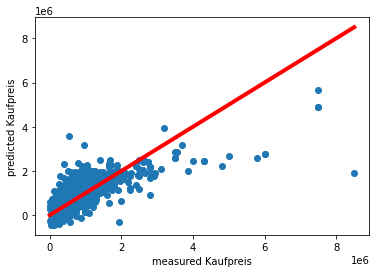

In [37]:
fig, ax = plt.subplots()
ax.scatter(test_y, y_predicted)
ax.plot([test_y.min(), test_y.max()], [test_y.min(), test_y.max()], 'k-', color='red', lw=4)
ax.set_xlabel('measured Kaufpreis')
ax.set_ylabel('predicted Kaufpreis')
plt.show()

## 7. Tensorflow Neural Network (Price)



In [0]:
# Rename & extract the variable to predict
neuraldf = clean_df2
target = neuraldf.Kaufpreis
neuraldf.drop(['Kaufpreis'],axis = 1 , inplace = True)
neuraldf['Target'] = target

In [0]:
# Split into train & test set whereby train set is 80% of the data.

n_train = round(neuraldf.shape[0] * 0.8)
train = neuraldf[:n_train]
test = neuraldf[n_train:]

target = train['Target']
train.drop(['Target'], axis = 1, inplace = True)

truth = test['Target']
test.drop(['Target'], axis = 1, inplace = True)

In [40]:
# Initiate a sequential model (i.e., no recurrence)
NN_model = Sequential()

# Make the input layer
NN_model.add(Dense(128, kernel_initializer='normal',input_dim = train.shape[1], activation='relu'))

# Make hidden layers
NN_model.add(Dense(256, kernel_initializer='normal',activation='relu'))
NN_model.add(Dense(256, kernel_initializer='normal',activation='relu'))

# Make the output layer
NN_model.add(Dense(1, kernel_initializer='normal',activation='linear'))

# Compile the network
NN_model.compile(loss='mean_squared_error', optimizer='adam', metrics=['mean_absolute_error'])
NN_model.summary()


Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 128)               1287040   
_________________________________________________________________
dense_2 (Dense)              (None, 256)               33024     
_________________________________________________________________
dense_3 (Dense)              (None, 256)               65792     
_________________________________________________________________
dense_4 (Dense)              (None, 1)                 257       
Total params: 1,386,113
Trainable params: 1,386,113
Non-trainable params: 0
_________________________________________________________________


### 7.1. Checkpoint callback 

A backup system that saves the models learned at each epoch. It saves only the models that are better than the previous models.

A file is made for each new model, containing the weights & biases of each neuron. Any of these files can be loaded to instantiate the corresponding network.

In [0]:
# Define how to name the files
checkpoint_name = 'Weights-{epoch:03d}--{val_loss:.5f}.hdf5'
# Instantiate the checkpoint system
checkpoint = ModelCheckpoint(checkpoint_name, monitor='val_loss', verbose = 1, save_best_only = True, mode ='auto')
callbacks_list = [checkpoint]

### 7.2. Training the neural network 

In [42]:
history = NN_model.fit(train, target, epochs=50, 
             # No. of randomly sampled data points used to compute the errors at each epoch (avoid overfitting)
             batch_size=32, 
             # Size of validation set for cross-validation
             validation_split = 0.2, 
             # Link to checkpoint system, to check the best model previously built
             callbacks=callbacks_list)

Train on 4399 samples, validate on 1100 samples
Epoch 1/50
4399/4399 [==============================] - 4s 997us/step - loss: 766717668916.9575 - mean_absolute_error: 527048.0000 - val_loss: 492120277111.1564 - val_mean_absolute_error: 393301.6875

Epoch 00001: val_loss improved from inf to 492120277111.15637, saving model to Weights-001--492120277111.15637.hdf5
Epoch 2/50
4399/4399 [==============================] - 4s 886us/step - loss: 603540925103.6327 - mean_absolute_error: 426588.4062 - val_loss: 407145679600.1746 - val_mean_absolute_error: 337886.8438

Epoch 00002: val_loss improved from 492120277111.15637 to 407145679600.17456, saving model to Weights-002--407145679600.17456.hdf5
Epoch 3/50
4399/4399 [==============================] - 4s 896us/step - loss: 575555114677.9177 - mean_absolute_error: 426550.4375 - val_loss: 405165326038.1091 - val_mean_absolute_error: 344277.8750

Epoch 00003: val_loss improved from 407145679600.17456 to 405165326038.10907, saving model to Weights-

In [43]:
# Retrieve the hitory of every epoch's training
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

,val_loss,val_mean_absolute_error,loss,mean_absolute_error,epoch
45,3.850645e+11,359455.06250,5.026906e+11,394205.37500,45
46,3.664428e+11,301522.00000,5.093283e+11,396552.90625,46
47,3.864900e+11,363774.81250,4.997279e+11,390649.96875,47
48,3.706886e+11,287823.53125,5.016198e+11,393778.90625,48
49,3.659447e+11,326234.96875,4.989152e+11,389916.40625,49


In [0]:
# Check best checkpoint in local folder (the last file saved)
#   Paste the name of the last file saved by the checkpoint system
weights_file = 'Weights-050--365944675339.17090.hdf5'

# Load the parameters of the models (weights & bias)
NN_model.load_weights(weights_file)
NN_model.compile(loss='mean_squared_error', optimizer='adam', metrics=['mean_squared_error'])

In [0]:
prediction = NN_model.predict(test)

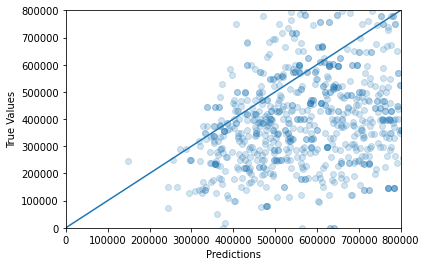

In [47]:
plt.figure()
plt.scatter(prediction, truth, alpha=0.2)
plt.xlabel('Predictions')
plt.ylabel('True Values')
lims = [0, 800000]
plt.xlim(lims)
plt.ylim(lims)
_ = plt.plot(lims, lims)
plt.show()

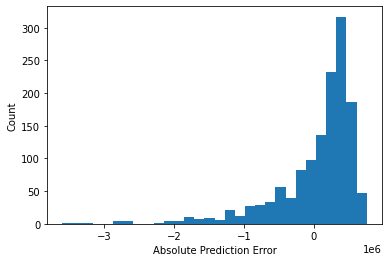

In [48]:
error = prediction - truth.to_numpy()
plt.figure()
plt.hist(error[0], bins = 30)
plt.xlabel("Absolute Prediction Error")
plt.ylabel("Count")
plt.show()